Code based on grokking colab here: https://colab.research.google.com/drive/1F6_1_cWXE5M7WocUcpQWp3v8z4b1jL20#scrollTo=X4DuPaBkwa0M


In [1]:
# Import stuff
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import numpy as np
import einops
import tqdm.notebook as tqdm

import random
import time

from pathlib import Path
import pickle
import os

import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import plotly.io as pio
pio.renderers.default = "colab"
import plotly.graph_objects as go

from torch.utils.data import DataLoader

from functools import *
import pandas as pd
import gc

import itertools
import wandb

wandb.login()
root = Path(Path.cwd() / 'saved_runs')
large_root = Path(Path.cwd() / 'large_files')

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: ryanz. Use `wandb login --relogin` to force relogin


In [2]:
# A helper class to get access to intermediate activations (inspired by Garcon)
# It's a dummy module that is the identity function by default
# I can wrap any intermediate activation in a HookPoint and get a convenient
# way to add PyTorch hooks
class HookPoint(nn.Module):
    def __init__(self):
        super().__init__()
        self.fwd_hooks = []
        self.bwd_hooks = []

    def give_name(self, name):
        # Called by the model at initialisation
        self.name = name

    def add_hook(self, hook, dir='fwd'):
        # Hook format is fn(activation, hook_name)
        # Change it into PyTorch hook format (this includes input and output,
        # which are the same for a HookPoint)
        def full_hook(module, module_input, module_output):
            return hook(module_output, name=self.name)
        if dir=='fwd':
            handle = self.register_forward_hook(full_hook)
            self.fwd_hooks.append(handle)
        elif dir=='bwd':
            handle = self.register_backward_hook(full_hook)
            self.bwd_hooks.append(handle)
        else:
            raise ValueError(f"Invalid direction {dir}")

    def remove_hooks(self, dir='fwd'):
        if (dir=='fwd') or (dir=='both'):
            for hook in self.fwd_hooks:
                hook.remove()
            self.fwd_hooks = []
        if (dir=='bwd') or (dir=='both'):
            for hook in self.bwd_hooks:
                hook.remove()
            self.bwd_hooks = []
        if dir not in ['fwd', 'bwd', 'both']:
            raise ValueError(f"Invalid direction {dir}")

    def forward(self, x):
        return x

In [3]:
# Embed & Unembed
class Embed(nn.Module):
    def __init__(self, d_vocab, d_model):
        super().__init__()
        self.W_E = nn.Parameter(torch.randn(d_model, d_vocab)/np.sqrt(d_model))

    def forward(self, x):
        return torch.einsum('dbp -> bpd', self.W_E[:, x])

class Unembed(nn.Module):
    def __init__(self, d_vocab, d_model):
        super().__init__()
        self.W_U = nn.Parameter(torch.randn(d_model, d_vocab)/np.sqrt(d_vocab))

    def forward(self, x):
        return (x @ self.W_U)

# Positional Embeddings
class PosEmbed(nn.Module):
    def __init__(self, max_ctx, d_model):
        super().__init__()
        self.W_pos = nn.Parameter(torch.randn(max_ctx, d_model)/np.sqrt(d_model))

    def forward(self, x):
        return x+self.W_pos[:x.shape[-2]]

# LayerNorm
class LayerNorm(nn.Module):
    def __init__(self, d_model, epsilon = 1e-4, model=[None]):
        super().__init__()
        self.model = model
        self.w_ln = nn.Parameter(torch.ones(d_model))
        self.b_ln = nn.Parameter(torch.zeros(d_model))
        self.epsilon = epsilon

    def forward(self, x):
        if self.model[0].use_ln:
            x = x - x.mean(axis=-1)[..., None]
            x = x / (x.std(axis=-1)[..., None] + self.epsilon)
            x = x * self.w_ln
            x = x + self.b_ln
            return x
        else:
            return x

# Attention
class Attention(nn.Module):
    def __init__(self, d_model, num_heads, d_head, n_ctx, model):
        super().__init__()
        self.model = model
        self.W_K = nn.Parameter(torch.randn(num_heads, d_head, d_model)/np.sqrt(d_model))
        self.W_Q = nn.Parameter(torch.randn(num_heads, d_head, d_model)/np.sqrt(d_model))
        self.W_V = nn.Parameter(torch.randn(num_heads, d_head, d_model)/np.sqrt(d_model))
        self.W_O = nn.Parameter(torch.randn(d_model, d_head * num_heads)/np.sqrt(d_model))
        self.register_buffer('mask', torch.tril(torch.ones((n_ctx, n_ctx))))
        self.d_head = d_head
        self.hook_k = HookPoint()
        self.hook_q = HookPoint()
        self.hook_v = HookPoint()
        self.hook_z = HookPoint()
        self.hook_attn = HookPoint()
        self.hook_attn_pre = HookPoint()

    def forward(self, x):
        # x: batch x position x dimension
        k = self.hook_k(torch.einsum('ihd,bpd->biph', self.W_K, x))
        q = self.hook_q(torch.einsum('ihd,bpd->biph', self.W_Q, x))
        v = self.hook_v(torch.einsum('ihd,bpd->biph', self.W_V, x))
        attn_scores_pre = torch.einsum('biph,biqh->biqp', k, q)
        attn_scores_masked = torch.tril(attn_scores_pre) - 1e10 * (1 - self.mask[:x.shape[-2], :x.shape[-2]])
        attn_matrix = self.hook_attn(F.softmax(self.hook_attn_pre(attn_scores_masked/np.sqrt(self.d_head)), dim=-1))
        z = self.hook_z(torch.einsum('biph,biqp->biqh', v, attn_matrix))
        z_flat = einops.rearrange(z, 'b i q h -> b q (i h)')
        out = torch.einsum('df,bqf->bqd', self.W_O, z_flat)
        return out

# MLP Layers
class MLP(nn.Module):
    def __init__(self, d_model, d_mlp, act_type, model):
        super().__init__()
        self.model = model
        self.W_in = nn.Parameter(torch.randn(d_mlp, d_model)/np.sqrt(d_model))
        self.b_in = nn.Parameter(torch.zeros(d_mlp))
        self.W_out = nn.Parameter(torch.randn(d_model, d_mlp)/np.sqrt(d_model))
        self.b_out = nn.Parameter(torch.zeros(d_model))
        self.act_type = act_type
        # self.ln = LayerNorm(d_mlp, model=self.model)
        self.hook_pre = HookPoint()
        self.hook_post = HookPoint()
        assert act_type in ['ReLU', 'GeLU']

    def forward(self, x):
        # x shape: (b, p, d_model)
        x = self.hook_pre(torch.einsum('md,bpd->bpm', self.W_in, x) + self.b_in)
        # x shape: (b, p, d_mlp)
        if self.act_type=='ReLU':
            x = F.relu(x)
        elif self.act_type=='GeLU':
            x = F.gelu(x)
        x = self.hook_post(x)
        # x shape: (b, p, d_mlp)
        x = torch.einsum('dm,bpm->bpd', self.W_out, x) + self.b_out
        # x shape: (b, p, d_model)
        return x

# Transformer Block
class TransformerBlock(nn.Module):
    def __init__(self, d_model, d_mlp, d_head, num_heads, n_ctx, act_type, model):
        super().__init__()
        self.model = model
        # self.ln1 = LayerNorm(d_model, model=self.model)
        self.attn = Attention(d_model, num_heads, d_head, n_ctx, model=self.model)
        # self.ln2 = LayerNorm(d_model, model=self.model)
        self.mlp = MLP(d_model, d_mlp, act_type, model=self.model)
        self.hook_attn_out = HookPoint()
        self.hook_mlp_out = HookPoint()
        self.hook_resid_pre = HookPoint()
        self.hook_resid_mid = HookPoint()
        self.hook_resid_post = HookPoint()

    def forward(self, x):
        # hook_attn_out shape: (b, p, d)
        x = self.hook_resid_mid(x + self.hook_attn_out(self.attn((self.hook_resid_pre(x)))))
        # x shape: (b, p, d)
        # MLP goes from d_model (d) to d_mlp
        # hook_mlp_out shape: (b, p, d)
        x = self.hook_resid_post(x + self.hook_mlp_out(self.mlp((x))))
        return x

# Full transformer
class Transformer(nn.Module):
    def __init__(self, num_layers, d_vocab, d_model, d_mlp, d_head, num_heads, n_ctx, act_type, use_cache=False, use_ln=True):
        super().__init__()
        self.cache = {}
        self.use_cache = use_cache

        self.embed = Embed(d_vocab, d_model)
        self.pos_embed = PosEmbed(n_ctx, d_model)
        self.blocks = nn.ModuleList([TransformerBlock(d_model, d_mlp, d_head, num_heads, n_ctx, act_type, model=[self]) for i in range(num_layers)])
        # self.ln = LayerNorm(d_model, model=[self])
        self.unembed = Unembed(d_vocab, d_model)
        self.use_ln = use_ln

        for name, module in self.named_modules():
            if type(module)==HookPoint:
                module.give_name(name)

    def forward(self, x):
        # x has shape (b, p, vocab)
        x = self.embed(x)
        # x has shape (b, p, d)
        x = self.pos_embed(x)
        # x has shape (b, p, d)
        for block in self.blocks:
            x = block(x)
        # x = self.ln(x)
        x = self.unembed(x)
        # x has shape (b, p, vocab)
        return x

    def set_use_cache(self, use_cache):
        self.use_cache = use_cache

    def hook_points(self):
        return [module for name, module in self.named_modules() if 'hook' in name]

    def remove_all_hooks(self):
        for hp in self.hook_points():
            hp.remove_hooks('fwd')
            hp.remove_hooks('bwd')

    def cache_all(self, cache, incl_bwd=False):
        # Caches all activations wrapped in a HookPoint
        def save_hook(tensor, name):
            cache[name] = tensor.detach()
        def save_hook_back(tensor, name):
            cache[name+'_grad'] = tensor[0].detach()
        for hp in self.hook_points():
            hp.add_hook(save_hook, 'fwd')
            if incl_bwd:
                hp.add_hook(save_hook_back, 'bwd')

In [4]:
# Helper functions
def cuda_memory():
    print(torch.cuda.memory_allocated()/1e9)

def cross_entropy_high_precision(logits, labels):
    # Shapes: batch x vocab, batch
    # Cast logits to float64 because log_softmax has a float32 underflow on overly
    # confident data and can only return multiples of 1.2e-7 (the smallest float x
    # such that 1+x is different from 1 in float32). This leads to loss spikes
    # and dodgy gradients
    logprobs = F.log_softmax(logits.to(torch.float64), dim=-1)
    prediction_logprobs = torch.gather(logprobs, index=labels[:, None], dim=-1)
    loss = -torch.mean(prediction_logprobs)
    return loss

def full_loss(model, data):
    # Take the final position only
    logits = model(data)[:, -1]
    labels = torch.tensor([fn(i, j) for i, j, _ in data]).to('cuda')
    return cross_entropy_high_precision(logits, labels)

def test_logits(logits, bias_correction=False, original_logits=None, mode='all'):
    # Calculates cross entropy loss of logits representing a batch of all p^2
    # possible inputs
    # Batch dimension is assumed to be first
    if logits.shape[1]==p*p:
        logits = logits.T
    if logits.shape==torch.Size([p*p, p+1]):
        logits = logits[:, :-1]
    logits = logits.reshape(p*p, p)
    if bias_correction:
        # Applies bias correction - we correct for any missing bias terms,
        # independent of the input, by centering the new logits along the batch
        # dimension, and then adding the average original logits across all inputs
        logits = einops.reduce(original_logits - logits, 'batch ... -> ...', 'mean') + logits
    if mode=='train':
        return cross_entropy_high_precision(logits[is_train], labels[is_train])
    elif mode=='test':
        return cross_entropy_high_precision(logits[is_test], labels[is_test])
    elif mode=='all':
        return cross_entropy_high_precision(logits, labels)

In [5]:
#Plotting functions
# This is mostly a bunch of over-engineered mess to hack Plotly into producing
# the pretty pictures I want, I recommend not reading too closely unless you
# want Plotly hacking practice
def to_numpy(tensor, flat=False):
    if type(tensor)!=torch.Tensor:
        return tensor
    if flat:
        return tensor.flatten().detach().cpu().numpy()
    else:
        return tensor.detach().cpu().numpy()
def imshow(tensor, xaxis=None, yaxis=None, animation_name='Snapshot', **kwargs):
    if tensor.shape[0]==p*p:
        tensor = unflatten_first(tensor)
    tensor = torch.squeeze(tensor)
    px.imshow(to_numpy(tensor, flat=False),
              labels={'x':xaxis, 'y':yaxis, 'animation_name':animation_name},
              **kwargs).show()
# Set default colour scheme
imshow = partial(imshow, color_continuous_scale='Blues')
# Creates good defaults for showing divergent colour scales (ie with both
# positive and negative values, where 0 is white)
imshow_div = partial(imshow, color_continuous_scale='RdBu', color_continuous_midpoint=0.0)
# Presets a bunch of defaults to imshow to make it suitable for showing heatmaps
# of activations with x axis being input 1 and y axis being input 2.
inputs_heatmap = partial(imshow, xaxis='Input 1', yaxis='Input 2', color_continuous_scale='RdBu', color_continuous_midpoint=0.0)
def line(x, y=None, hover=None, xaxis='', yaxis='', **kwargs):
    if type(y)==torch.Tensor:
        y = to_numpy(y, flat=True)
    if type(x)==torch.Tensor:
        x=to_numpy(x, flat=True)
    fig = px.line(x, y=y, hover_name=hover, **kwargs)
    fig.update_layout(xaxis_title=xaxis, yaxis_title=yaxis)
    fig.show()
def scatter(x, y, **kwargs):
    px.scatter(x=to_numpy(x, flat=True), y=to_numpy(y, flat=True), **kwargs).show()
def lines(lines_list, x=None, mode='lines', labels=None, xaxis='', yaxis='', title = '', log_y=False, hover=None, **kwargs):
    # Helper function to plot multiple lines
    if type(lines_list)==torch.Tensor:
        lines_list = [lines_list[i] for i in range(lines_list.shape[0])]
    if x is None:
        x=np.arange(len(lines_list[0]))
    fig = go.Figure(layout={'title':title})
    fig.update_xaxes(title=xaxis)
    fig.update_yaxes(title=yaxis)
    for c, line in enumerate(lines_list):
        if type(line)==torch.Tensor:
            line = to_numpy(line)
        if labels is not None:
            label = labels[c]
        else:
            label = c
        fig.add_trace(go.Scatter(x=x, y=line, mode=mode, name=label, hovertext=hover, **kwargs))
    if log_y:
        fig.update_layout(yaxis_type="log")
    fig.show()
def line_marker(x, **kwargs):
    lines([x], mode='lines+markers', **kwargs)
def animate_lines(lines_list, snapshot_index = None, snapshot='snapshot', hover=None, xaxis='x', yaxis='y', **kwargs):
    if type(lines_list)==list:
        lines_list = torch.stack(lines_list, axis=0)
    lines_list = to_numpy(lines_list, flat=False)
    if snapshot_index is None:
        snapshot_index = np.arange(lines_list.shape[0])
    if hover is not None:
        hover = [i for j in range(len(snapshot_index)) for i in hover]
    print(lines_list.shape)
    rows=[]
    for i in range(lines_list.shape[0]):
        for j in range(lines_list.shape[1]):
            rows.append([lines_list[i][j], snapshot_index[i], j])
    df = pd.DataFrame(rows, columns=[yaxis, snapshot, xaxis])
    px.line(df, x=xaxis, y=yaxis, animation_frame=snapshot, range_y=[lines_list.min(), lines_list.max()], hover_name=hover,**kwargs).show()

def imshow_fourier(tensor, title='', animation_name='snapshot', facet_labels=[], **kwargs):
    # Set nice defaults for plotting functions in the 2D fourier basis
    # tensor is assumed to already be in the Fourier Basis
    if tensor.shape[0]==p*p:
        tensor = unflatten_first(tensor)
    tensor = torch.squeeze(tensor)
    fig=px.imshow(to_numpy(tensor),
            x=fourier_basis_names,
            y=fourier_basis_names,
            labels={'x':'x Component',
                    'y':'y Component',
                    'animation_frame':animation_name},
            title=title,
            color_continuous_midpoint=0.,
            color_continuous_scale='RdBu',
            **kwargs)
    fig.update(data=[{'hovertemplate':"%{x}x * %{y}y<br>Value:%{z:.4f}"}])
    if facet_labels:
        for i, label in enumerate(facet_labels):
            fig.layout.annotations[i]['text'] = label
    fig.show()

def animate_multi_lines(lines_list, y_index=None, snapshot_index = None, snapshot='snapshot', hover=None, swap_y_animate=False, **kwargs):
    # Can plot an animation of lines with multiple lines on the plot.
    if type(lines_list)==list:
        lines_list = torch.stack(lines_list, axis=0)
    lines_list = to_numpy(lines_list, flat=False)
    if swap_y_animate:
        lines_list = lines_list.transpose(1, 0, 2)
    if snapshot_index is None:
        snapshot_index = np.arange(lines_list.shape[0])
    if y_index is None:
        y_index = [str(i) for i in range(lines_list.shape[1])]
    if hover is not None:
        hover = [i for j in range(len(snapshot_index)) for i in hover]
    print(lines_list.shape)
    rows=[]
    for i in range(lines_list.shape[0]):
        for j in range(lines_list.shape[2]):
            rows.append(list(lines_list[i, :, j])+[snapshot_index[i], j])
    df = pd.DataFrame(rows, columns=y_index+[snapshot, 'x'])
    px.line(df, x='x', y=y_index, animation_frame=snapshot, range_y=[lines_list.min(), lines_list.max()], hover_name=hover, **kwargs).show()

def animate_scatter(lines_list, snapshot_index = None, snapshot='snapshot', hover=None, yaxis='y', xaxis='x', color=None, color_name = 'color', **kwargs):
    # Can plot an animated scatter plot
    # lines_list has shape snapshot x 2 x line
    if type(lines_list)==list:
        lines_list = torch.stack(lines_list, axis=0)
    lines_list = to_numpy(lines_list, flat=False)
    if snapshot_index is None:
        snapshot_index = np.arange(lines_list.shape[0])
    if hover is not None:
        hover = [i for j in range(len(snapshot_index)) for i in hover]
    if color is None:
        color = np.ones(lines_list.shape[-1])
    if type(color)==torch.Tensor:
        color = to_numpy(color)
    if len(color.shape)==1:
        color = einops.repeat(color, 'x -> snapshot x', snapshot=lines_list.shape[0])
    print(lines_list.shape)
    rows=[]
    for i in range(lines_list.shape[0]):
        for j in range(lines_list.shape[2]):
            rows.append([lines_list[i, 0, j].item(), lines_list[i, 1, j].item(), snapshot_index[i], color[i, j]])
    print([lines_list[:, 0].min(), lines_list[:, 0].max()])
    print([lines_list[:, 1].min(), lines_list[:, 1].max()])
    df = pd.DataFrame(rows, columns=[xaxis, yaxis, snapshot, color_name])
    px.scatter(df, x=xaxis, y=yaxis, animation_frame=snapshot, range_x=[lines_list[:, 0].min(), lines_list[:, 0].max()], range_y=[lines_list[:, 1].min(), lines_list[:, 1].max()], hover_name=hover, color=color_name, **kwargs).show()

In [6]:
def unflatten_first(tensor):
    if tensor.shape[0]==p*p:
        return einops.rearrange(tensor, '(x y) ... -> x y ...', x=p, y=p)
    else:
        return tensor
def cos(x, y):
    return (x.dot(y))/x.norm()/y.norm()
def mod_div(a, b):
    return (a*pow(b, p-2, p))%p
def normalize(tensor, axis=0):
    return tensor/(tensor).pow(2).sum(keepdim=True, axis=axis).sqrt()
def extract_freq_2d(tensor, freq):
    # Takes in a pxpx... or batch x ... tensor, returns a 3x3x... tensor of the
    # Linear and quadratic terms of frequency freq
    tensor = unflatten_first(tensor)
    # Extracts the linear and quadratic terms corresponding to frequency freq
    index_1d = [0, 2*freq-1, 2*freq]
    # Some dumb manipulation to use fancy array indexing rules
    # Gets the rows and columns in index_1d
    return tensor[[[i]*3 for i in index_1d], [index_1d]*3]
def get_cov(tensor, norm=True):
    # Calculate covariance matrix
    if norm:
        tensor = normalize(tensor, axis=1)
    return tensor @ tensor.T
def is_close(a, b):
    return ((a-b).pow(2).sum()/(a.pow(2).sum().sqrt())/(b.pow(2).sum().sqrt())).item()

def fft1d(tensor):
    # Converts a tensor with dimension p into the Fourier basis
    return tensor @ fourier_basis.T

def fourier_2d_basis_term(x_index, y_index):
    # Returns the 2D Fourier basis term corresponding to the outer product of
    # the x_index th component in the x direction and y_index th component in the
    # y direction
    # Returns a 1D vector of length p^2
    return (fourier_basis[x_index][:, None] * fourier_basis[y_index][None, :]).flatten()

def fft2d(mat):
    # Converts a pxpx... or batch x ... tensor into the 2D Fourier basis.
    # Output has the same shape as the original
    shape = mat.shape
    mat = einops.rearrange(mat, '(x y) ... -> x y (...)', x=p, y=p)
    fourier_mat = torch.einsum('xyz,fx,Fy->fFz', mat, fourier_basis, fourier_basis)
    return fourier_mat.reshape(shape)

def analyse_fourier_2d(tensor, top_k=10):
    # Processes a (p,p) or (p*p) tensor in the 2D Fourier Basis, showing the
    # top_k terms and how large a fraction of the variance they explain
    values, indices = tensor.flatten().pow(2).sort(descending=True)
    rows = []
    total = values.sum().item()
    for i in range(top_k):
        rows.append([tensor.flatten()[indices[i]].item(),
                     values[i].item()/total,
                     values[:i+1].sum().item()/total,
                     fourier_basis_names[indices[i].item()//p],
                     fourier_basis_names[indices[i]%p]])
    display(pd.DataFrame(rows, columns=['Coefficient', 'Frac explained', 'Cumulative frac explained', 'x', 'y']))

def get_2d_fourier_component(tensor, x, y):
    # Takes in a batch x ... tensor and projects it onto the 2D Fourier Component
    # (x, y)
    vec = fourier_2d_basis_term(x, y).flatten()
    return vec[:, None] @ (vec[None, :] @ tensor)

def get_component_cos_xpy(tensor, freq, collapse_dim=False):
    # Gets the component corresponding to cos(freq*(x+y)) in the 2D Fourier basis
    # This is equivalent to the matrix cos((x+y)*freq*2pi/p)
    cosx_cosy_direction = fourier_2d_basis_term(2*freq-1, 2*freq-1).flatten()
    sinx_siny_direction = fourier_2d_basis_term(2*freq, 2*freq).flatten()
    # Divide by sqrt(2) to ensure it remains normalised
    cos_xpy_direction = (cosx_cosy_direction - sinx_siny_direction)/np.sqrt(2)
    # Collapse_dim says whether to project back into R^(p*p) space or not
    if collapse_dim:
        return (cos_xpy_direction @ tensor)
    else:
        return cos_xpy_direction[:, None] @ (cos_xpy_direction[None, :] @ tensor)

def get_component_sin_xpy(tensor, freq, collapse_dim=False):
    # Gets the component corresponding to sin((x+y)*freq*2pi/p) in the 2D Fourier basis
    sinx_cosy_direction = fourier_2d_basis_term(2*freq, 2*freq-1).flatten()
    cosx_siny_direction = fourier_2d_basis_term(2*freq-1, 2*freq).flatten()
    sin_xpy_direction = (sinx_cosy_direction + cosx_siny_direction)/np.sqrt(2)
    if collapse_dim:
        return (sin_xpy_direction @ tensor)
    else:
        return sin_xpy_direction[:, None] @ (sin_xpy_direction[None, :] @ tensor)

In [7]:
def seed_everything(seed):
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.use_deterministic_algorithms(True)
    torch.backends.cudnn.benchmark = False
    os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":4096:8"


In [8]:
# hyperparameters

lr=1e-3 #@param
weight_decay = 1.0 #@param
p=113 #@param
d_model = 128 #@param
fn_name = 'add' #@param ['add', 'subtract', 'x2xyy2','rand']
frac_train = 0.3 #@param
num_epochs = 50000 #@param
save_models = True #@param
save_every = 100 #@param
# Stop training when test loss is <stopping_thresh
stopping_thresh = -1 #@param
seed = 0 #@param
optimizer_name = 'AdamW'

num_layers = 1
batch_style = 'full'
d_vocab = p+1
n_ctx = 3
d_mlp = 4*d_model
num_heads = 4
assert d_model % num_heads == 0
d_head = d_model//num_heads
act_type = 'ReLU' #@param ['ReLU', 'GeLU']
# batch_size = 512
use_ln = False
random_answers = np.random.randint(low=0, high=p, size=(p, p))
fns_dict = {'add': lambda x,y:(x+y)%p, 'subtract': lambda x,y:(x-y)%p, 'x2xyy2':lambda x,y:(x**2+x*y+y**2)%p, 'rand':lambda x,y:random_answers[x][y]}
fn = fns_dict[fn_name]

config=dict(
    lr = lr,
    weight_decay = weight_decay,
    p = p,
    d_model = d_model,
    fn_name = fn_name,
    frac_train = frac_train,
    num_epochs = num_epochs,
    save_models = save_models,
    save_every = save_every,
    stopping_thresh = stopping_thresh,
    seed = seed,
    optimizer_name = optimizer_name,
    num_layers = num_layers,
    batch_style = batch_style,
    d_vocab = d_vocab,
    n_ctx = n_ctx,
    d_mlp = d_mlp,
    num_heads = num_heads,
    d_head = d_head,
    act_type = act_type,
    use_ln = use_ln,
)

seed_everything(seed)

In [9]:
def gen_train_test(frac_train, num, seed=0):
    # Generate train and test split
    pairs = [(i, j, num) for i in range(num) for j in range(num)]
    random.seed(seed)
    random.shuffle(pairs)
    div = int(frac_train*len(pairs))
    return pairs[:div], pairs[div:]

train, test = gen_train_test(frac_train, p, seed)
print(len(train), len(test))

# Creates an array of Boolean indices according to whether each data point is in
# train or test
# Used to index into the big batch of all possible data
is_train = []
is_test = []
for x in range(p):
    for y in range(p):
        if (x, y, 113) in train:
            is_train.append(True)
            is_test.append(False)
        else:
            is_train.append(False)
            is_test.append(True)
is_train = np.array(is_train)
is_test = np.array(is_test)

3830 8939


# Training

In [10]:
train_model = False #@param
seed_everything(seed)

if train_model:
    with wandb.init(project = 'grok_lottery', name = f'{fn_name} seed:{seed}', config = config) as run:
        model = Transformer(num_layers=num_layers, d_vocab=d_vocab, d_model=d_model, d_mlp=d_mlp, d_head=d_head, num_heads=num_heads, n_ctx=n_ctx, act_type=act_type, use_cache=False, use_ln=use_ln)
        model.to('cuda')
        if optimizer_name == 'AdamW':
            optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay, betas=(0.9, 0.98))
        elif optimizer_name == 'SGD':
            optimizer = optim.SGD(model.parameters(), lr=lr, weight_decay=weight_decay)
        scheduler = optim.lr_scheduler.LambdaLR(optimizer, lambda step: min(step/10, 1))
        run_name = f"grok_{int(time.time())}"
        print(f'Run name {run_name}')
        if save_models:
            (root/run_name).mkdir(parents=True, exist_ok=True)
            save_dict = {'model':model.state_dict(), 'train_data':train, 'test_data':test}
            torch.save(save_dict, root/run_name/'init.pth')
            
        wandb.watch(model, log='all', log_freq=100)
        train_losses = []
        test_losses = []
        for epoch in range(num_epochs):

            train_loss = full_loss(model, train)
            test_loss = full_loss(model, test)
            train_losses.append(train_loss.item())
            test_losses.append(test_loss.item())
            if epoch%100 == 0:
                print(f"{epoch}_{np.log(train_loss.item()):.4f}_{np.log(test_loss.item()):.4f}")#_{train_acc.item():.4f}_{test_acc.item():.4f}")
                wandb.log({"epoch": epoch,
                           "train_loss": np.log(train_loss.item()),
                           "test_loss": np.log(test_loss.item()),
                           "scheduler_lr": scheduler.get_last_lr()[0]
                          })
            train_loss.backward()
            optimizer.step()
            scheduler.step()
            optimizer.zero_grad()
            if test_loss.item() < stopping_thresh:
                break
            if (save_models) and (epoch%save_every == 0):
                if test_loss.item() < stopping_thresh:
                    break
                save_dict = {
                    'model': model.state_dict(),
                    'optimizer': optimizer.state_dict(),
                    'scheduler': scheduler.state_dict(),
                    'train_loss': train_loss,
                    'test_loss': test_loss,
                    'epoch': epoch,
                }
                torch.save(save_dict, root/run_name/f"{epoch}.pth")
                print(f"Saved model to {root/run_name/f'{epoch}.pth'}")
    if not save_models:
        (root/run_name).mkdir(parents=True, exist_ok=True)
    save_dict = {
        'model': model.state_dict(),
        'optimizer': optimizer.state_dict(),
        'scheduler': scheduler.state_dict(),
        'train_loss': train_loss,
        'test_loss': test_loss,
        'train_losses': train_losses,
        'test_losses': test_losses,
        'epoch': epoch,
    }
    torch.save(save_dict, root/run_name/f"final.pth")
    print(f"Saved model to {root/run_name/f'final.pth'}")
    lines([train_losses, test_losses], labels=['train', 'test'], log_y=True)



# Analysis 

In [219]:
# Inspect the trained model
# data_path = './saved_runs/baseline_seed_0/final.pth'
# data_path = './saved_runs/mlp_pruning_20/final.pth'
# data_path = './saved_runs/attn_pruning_20/final.pth'
# data_path = './saved_runs/always_on_pruning/final.pth'
data_path = './saved_runs/freq_52_pruning/final.pth'
full_data = torch.load(data_path)
model = Transformer(num_layers=num_layers, d_vocab=d_vocab, d_model=d_model, d_mlp=d_mlp, d_head=d_head, num_heads=num_heads, n_ctx=n_ctx, act_type=act_type, use_cache=False, use_ln=use_ln)
model.to('cuda')
model.load_state_dict(full_data['model'])

<All keys matched successfully>

In [220]:
# Helper variables
W_O = einops.rearrange(model.blocks[0].attn.W_O, 'm (i h)->i m h', i=num_heads)
W_K = model.blocks[0].attn.W_K
W_Q = model.blocks[0].attn.W_Q
W_V = model.blocks[0].attn.W_V
W_in = model.blocks[0].mlp.W_in
W_out = model.blocks[0].mlp.W_out
W_pos = model.pos_embed.W_pos.T
# We remove the equals sign dimension from the Embed and Unembed, so we can 
# apply a Fourier Transform over R^p
W_E = model.embed.W_E[:, :-1]
W_U = model.unembed.W_U[:, :-1].T

# The initial value of the residual stream at position 2 - constant for all inputs
final_pos_resid_initial = model.embed.W_E[:, -1] + W_pos[:, 2]
print('W_O', W_O.shape)
print('W_K', W_K.shape)
print('W_Q', W_Q.shape)
print('W_V', W_V.shape)
print('W_in', W_in.shape)
print('W_out', W_out.shape)
print('W_pos', W_pos.shape)
print('W_E', W_E.shape)
print('W_U', W_U.shape)
print('Initial residual stream value at final pos:', final_pos_resid_initial.shape)

W_O torch.Size([4, 128, 32])
W_K torch.Size([4, 32, 128])
W_Q torch.Size([4, 32, 128])
W_V torch.Size([4, 32, 128])
W_in torch.Size([512, 128])
W_out torch.Size([128, 512])
W_pos torch.Size([128, 3])
W_E torch.Size([128, 113])
W_U torch.Size([113, 128])
Initial residual stream value at final pos: torch.Size([128])


In [221]:
imshow(abs(W_out), title = 'abs(W_out)')

Text(0.5, 1.0, 'Distribution of abs(W_out)')

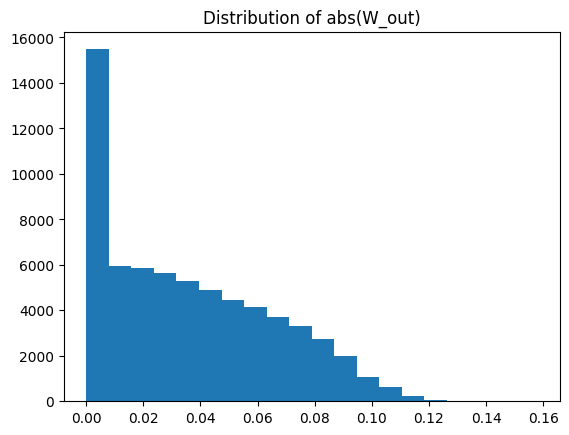

In [222]:
plt.hist(abs(W_out).flatten().cpu().detach(), bins=20)
plt.gca().set_title('Distribution of abs(W_out)')

In [223]:
imshow(abs(W_U @ W_out), title = 'abs(W_U @ W_out)')

Text(0.5, 1.0, 'Distribution of abs(W_U @ W_out)')

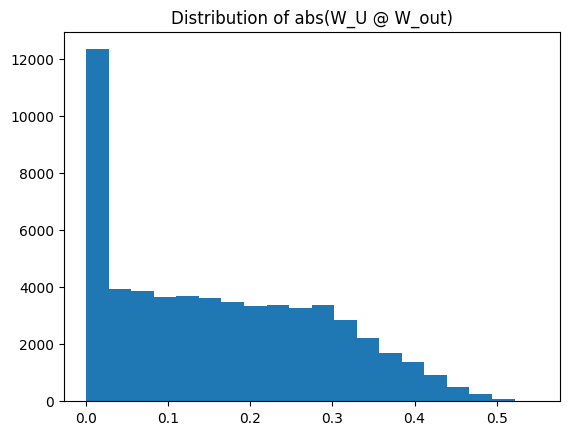

In [224]:
plt.hist(abs(W_U @ W_out).flatten().cpu().detach(), bins=20)
plt.gca().set_title('Distribution of abs(W_U @ W_out)')

In [225]:
[(name, par.shape) for name, par in model.named_parameters()]

[('embed.W_E', torch.Size([128, 114])),
 ('pos_embed.W_pos', torch.Size([3, 128])),
 ('blocks.0.attn.W_K', torch.Size([4, 32, 128])),
 ('blocks.0.attn.W_Q', torch.Size([4, 32, 128])),
 ('blocks.0.attn.W_V', torch.Size([4, 32, 128])),
 ('blocks.0.attn.W_O', torch.Size([128, 128])),
 ('blocks.0.mlp.W_in', torch.Size([512, 128])),
 ('blocks.0.mlp.b_in', torch.Size([512])),
 ('blocks.0.mlp.W_out', torch.Size([128, 512])),
 ('blocks.0.mlp.b_out', torch.Size([128])),
 ('unembed.W_U', torch.Size([128, 114]))]

In [226]:
all_data = torch.tensor([(i, j, p) for i in range(p) for j in range(p)]).to('cuda')
labels = torch.tensor([fn(i, j) for i, j, _ in all_data]).to('cuda')
cache = {}
model.remove_all_hooks()
model.cache_all(cache)
# Final position only
original_logits = model(all_data)[:, -1]
# Remove equals sign from output logits
original_logits = original_logits[:, :-1]
original_loss = cross_entropy_high_precision(original_logits, labels)
print(f"Original loss: {original_loss.item()}")


Original loss: 1.5049969204144254e-07


In [227]:
for k in cache.keys():
    print(k, cache[k].shape)

blocks.0.hook_resid_pre torch.Size([12769, 3, 128])
blocks.0.attn.hook_k torch.Size([12769, 4, 3, 32])
blocks.0.attn.hook_q torch.Size([12769, 4, 3, 32])
blocks.0.attn.hook_v torch.Size([12769, 4, 3, 32])
blocks.0.attn.hook_attn_pre torch.Size([12769, 4, 3, 3])
blocks.0.attn.hook_attn torch.Size([12769, 4, 3, 3])
blocks.0.attn.hook_z torch.Size([12769, 4, 3, 32])
blocks.0.hook_attn_out torch.Size([12769, 3, 128])
blocks.0.hook_resid_mid torch.Size([12769, 3, 128])
blocks.0.mlp.hook_pre torch.Size([12769, 3, 512])
blocks.0.mlp.hook_post torch.Size([12769, 3, 512])
blocks.0.hook_mlp_out torch.Size([12769, 3, 128])
blocks.0.hook_resid_post torch.Size([12769, 3, 128])


In [228]:
# Extracts out key activations
# we're looking at attention from token 2 to the previous two tokens
attn_mat = cache['blocks.0.attn.hook_attn'][:, :, 2, :2]
print('Attention Matrix:', attn_mat.shape)
neuron_acts = cache['blocks.0.mlp.hook_post'][:, -1]
print('Neuron Activations:', neuron_acts.shape)
neuron_acts_pre = cache['blocks.0.mlp.hook_pre'][:, -1]
print('Neuron Activations Pre:', neuron_acts_pre.shape)

Attention Matrix: torch.Size([12769, 4, 2])
Neuron Activations: torch.Size([12769, 512])
Neuron Activations Pre: torch.Size([12769, 512])


In [229]:
lines(lines_list=[full_data['train_losses'], 
                  full_data['test_losses']], 
      labels=['train loss', 'test loss'], 
      title='Grokking Training Curve', 
      x=np.arange(num_epochs),
      xaxis='Epoch',
      yaxis='Loss',
      log_y=True)

In [230]:
fourier_basis = []
fourier_basis.append(torch.ones(p)/np.sqrt(p))
fourier_basis_names = ['Const']
# Note that if p is even, we need to explicitly add a term for cos(kpi), ie 
# alternating +1 and -1
for i in range(1, p//2 +1):
    fourier_basis.append(torch.cos(2*torch.pi*torch.arange(p)*i/p))
    fourier_basis.append(torch.sin(2*torch.pi*torch.arange(p)*i/p))
    fourier_basis[-2]/=fourier_basis[-2].norm()
    fourier_basis[-1]/=fourier_basis[-1].norm()
    fourier_basis_names.append(f'cos {i}')
    fourier_basis_names.append(f'sin {i}')
fourier_basis = torch.stack(fourier_basis, dim=0).to('cuda')
# animate_lines(fourier_basis, snapshot_index=fourier_basis_names, snapshot='Fourier Component', title='Graphs of Fourier Components (Use Slider)')

In [231]:
example_fn = fourier_2d_basis_term(4, 6)+fourier_2d_basis_term(14, 46)/3+fourier_2d_basis_term(97, 100)/6
example_fn = example_fn.reshape(p, p)
imshow(example_fn)

In [232]:
imshow_fourier(fourier_basis @ example_fn @ fourier_basis.T,
               title='Example fn in 2D Fourier Basis')

In [233]:
attn_mat.shape

torch.Size([12769, 4, 2])

In [234]:
attn_mat[:,:,0].shape

torch.Size([12769, 4])

In [235]:
inputs_heatmap(attn_mat[:, :,  0], 
           title=f'Attention score for heads at position 0',
           animation_frame=2,
           animation_name='Head')


In [236]:
# this is the attention paid from position 2 to position 0
imshow_fourier(fft2d(attn_mat[:, :, 0]), 
           title=f'Attention score for heads position 0 in Fourier Basis',
           animation_frame=2,
           animation_name='Head')


In [237]:
top_k=5
inputs_heatmap(neuron_acts[:, :top_k], 
           title=f'Activations for first {top_k} neurons',
           animation_frame=2)

In [238]:
# embedding matrix
line((W_E @ fourier_basis.T).pow(2).sum(0), 
     hover=fourier_basis_names,
     title='Norm of embedding of each Fourier Component',
     xaxis='Fourier Component',
     yaxis='Norm')

In [239]:
# Center the neurons to remove the constant term
neuron_acts_centered = neuron_acts - einops.reduce(neuron_acts, 'batch neuron -> 1 neuron', 'mean')
# Note that fourier_neuron_acts[(0, 0), i]==0 for all i, because we centered the activations
fourier_neuron_acts = fft2d(neuron_acts_centered)
imshow_fourier(einops.reduce(fourier_neuron_acts.pow(2), 'batch neuron -> batch', 'mean'), 
               title='Norm of 2D Fourier components of neuron activations (excl const)')

In [240]:
fourier_neuron_acts_square = fourier_neuron_acts.reshape(p, p, d_mlp)
neuron_freqs = []
neuron_frac_explained = []
for ni in range(d_mlp):
    best_frac_explained = -1e6
    best_freq = -100
    for freq in range(1, p//2):
        # We extract the linear and quadratic fourier terms of frequency freq, 
        # and look at how much of the variance of the full vector this explains
        # If neurons specialise into specific frequencies, one frequency should 
        # have a large value
        frac_explained = (extract_freq_2d(fourier_neuron_acts_square[:, :, ni], freq).pow(2).sum()/
                          fourier_neuron_acts_square[:, :, ni].pow(2).sum()).item()
        if frac_explained > best_frac_explained:
            best_freq = freq
            best_frac_explained = frac_explained
    neuron_freqs.append(best_freq)
    neuron_frac_explained.append(best_frac_explained)
neuron_freqs = np.array(neuron_freqs)
neuron_frac_explained = np.array(neuron_frac_explained)
key_freqs, neuron_freq_counts = np.unique(neuron_freqs, return_counts=True)
print('Key freqs:', key_freqs)
print('Counts:', neuron_freq_counts)

Key freqs: [-100   41   42   49   55]
Counts: [ 75 140  73 115 109]


In [241]:
activation_uptime = to_numpy(einops.reduce((cache['blocks.0.mlp.hook_pre'][:, -1]>0).float(), 'batch neuron -> neuron', 'mean'))
active_neurons = (activation_uptime > 0)
# color: how many data points they're active for - the "always on" neurons are constantly active (yellow)
scatter(x=neuron_freqs[active_neurons], 
        y=neuron_frac_explained[active_neurons], 
        labels={'x':'Neuron frequency', 
                'y':'Frac explained'},
        color=activation_uptime[active_neurons],
        color_continuous_scale='Viridis')

Text(0, 0.5, 'Count')

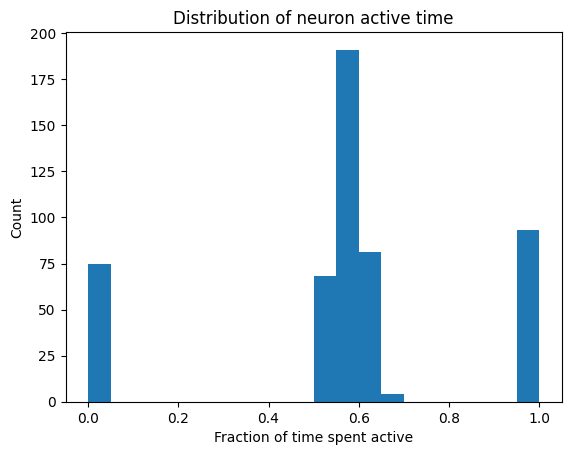

In [242]:
plt.hist(activation_uptime, bins = 20)
plt.gca().set_title("Distribution of neuron active time")
plt.gca().set_xlabel("Fraction of time spent active")
plt.gca().set_ylabel("Count")


In [243]:
# To represent that they are in a special sixth cluster, we set the 
# frequency of these neurons to -1

# neuron_freqs[neuron_frac_explained < 0.85] = -1.
neuron_freqs[activation_uptime > 0.9] = -1. # split these neurons by uptime instead
key_freqs_plus = np.concatenate([key_freqs, np.array([-1])])

scatter(x=neuron_freqs[active_neurons], 
        y=neuron_frac_explained[active_neurons], 
        labels={'x':'Neuron frequency', 
                'y':'Frac explained'},
        color=activation_uptime[active_neurons],
        color_continuous_scale='Viridis')

key_freqs_filtered, neuron_freq_counts_filtered = np.unique(neuron_freqs, return_counts=True)
print('Key freqs:', key_freqs_filtered)
print('Counts:', neuron_freq_counts_filtered)

Key freqs: [-100   -1   41   42   49   55]
Counts: [ 75  93 115  73  75  81]


In [244]:
imshow_fourier(einops.reduce(fourier_neuron_acts[:, neuron_freqs==-1].pow(2), 
                            'batch neuron -> batch', 
                            'sum'))

In [245]:
imshow_fourier(einops.reduce(fourier_neuron_acts[:, neuron_freqs==14].pow(2), 
                            'batch neuron -> batch', 
                            'sum'))

In [246]:
imshow_fourier(einops.reduce(fourier_neuron_acts[:, neuron_freqs==16].pow(2), 
                            'batch neuron -> batch', 
                            'sum'))

In [247]:
key_freqs_with_inactive = key_freqs
key_freqs = key_freqs[key_freqs>0]

In [248]:
trig_logits = sum([get_component_cos_xpy(original_logits, freq) + 
                   get_component_sin_xpy(original_logits, freq)
                   for freq in key_freqs])

print('Loss with just x+y components:', test_logits(trig_logits, True, original_logits).item())
print("Original Loss:", original_loss.item())

Loss with just x+y components: 5.615388850750604e-08
Original Loss: 1.5049969204144254e-07


In [249]:
def get_component_cos_xpy(tensor, freq, collapse_dim=False):
    # Gets the component corresponding to cos(freq*(x+y)) in the 2D Fourier basis
    # This is equivalent to the matrix cos((x+y)*freq*2pi/p)
    cosx_cosy_direction = fourier_2d_basis_term(2*freq-1, 2*freq-1).flatten()
    sinx_siny_direction = fourier_2d_basis_term(2*freq, 2*freq).flatten()
    # Divide by sqrt(2) to ensure it remains normalised
    cos_xpy_direction = (cosx_cosy_direction - sinx_siny_direction)/np.sqrt(2)
    # Collapse_dim says whether to project back into R^(p*p) space or not
    if collapse_dim:
        return (cos_xpy_direction @ tensor)
    else:
        return cos_xpy_direction[:, None] @ (cos_xpy_direction[None, :] @ tensor)

In [250]:
# logits_in_freqs: constrained to their key freq (except the always on freq==-1 neurons)
# filtered_logits: unconstrained logits, but split by their key freq

logits_in_freqs = []
filtered_logits = []
filtered_neuron_acts_list = []
filtered_neuron_acts_in_freq_list = []
for freq in key_freqs:
    filtered_neuron_acts = neuron_acts[:, neuron_freqs==freq]
    filtered_neuron_acts_in_freq = sum([get_2d_fourier_component(filtered_neuron_acts, x, y) for x in [0, 2*freq-1, 2*freq] for y in [0, 2*freq-1, 2*freq]])

    filtered_neuron_acts_list.append(filtered_neuron_acts)
    filtered_neuron_acts_in_freq_list.append(filtered_neuron_acts_in_freq)
    logits_in_freqs.append(filtered_neuron_acts_in_freq @ W_out.T[neuron_freqs==freq] @ W_U.T)
    filtered_logits.append(filtered_neuron_acts @ W_out.T[neuron_freqs==freq] @ W_U.T)
    
# We add on neurons in the always firing cluster, unfiltered by freq
filtered_neuron_acts_list.append(neuron_acts[:, neuron_freqs==-1])
filtered_neuron_acts_in_freq_list.append(neuron_acts[:, neuron_freqs==-1])
logits_in_freqs.append(neuron_acts[:, neuron_freqs==-1] @ W_out.T[neuron_freqs==-1] @ W_U.T)
filtered_logits.append(neuron_acts[:, neuron_freqs==-1] @ W_out.T[neuron_freqs==-1] @ W_U.T)
print('Loss with neuron activations ONLY in key freq (incl always firing cluster)', 
      test_logits(sum(logits_in_freqs), 
                  bias_correction=True, 
                  original_logits=original_logits).item())
print('Loss with neuron activations ONLY in key freq (excl always firing cluster)', 
      test_logits(sum(logits_in_freqs[:-1]), 
                  bias_correction=True, 
                  original_logits=original_logits).item())
print('Original loss:', original_loss.item())

Loss with neuron activations ONLY in key freq (incl always firing cluster) 2.326767671141552e-07
Loss with neuron activations ONLY in key freq (excl always firing cluster) 7.971145382235393e-05
Original loss: 1.5049969204144254e-07


In [251]:
inputs_heatmap(sum(filtered_logits[:]),animation_frame=2, title=f"Logit contribution from all neurons, epoch {full_data['epoch']}")

In [252]:
# compare the importance of each cluster of neurons by ablating it (while continuing to restrict each cluster to its frequency)
for c, freq in enumerate(key_freqs):
    print(f'Loss with freq-constrained neuron activations excluding frequency {freq}', 
      test_logits(sum(logits_in_freqs[:c]+logits_in_freqs[(c+1):]), 
                  bias_correction=True, 
                  original_logits=original_logits).item())
print(f'Loss with freq-constrained neuron activations excluding always firing cluster', 
    test_logits(sum(logits_in_freqs[:-1]), 
                bias_correction=True, 
                original_logits=original_logits).item())

print(f'Loss with all neuron activations, freq-constrained', 
    test_logits(sum(logits_in_freqs), 
                bias_correction=True, 
                original_logits=original_logits).item())
print('Original loss:', original_loss.item())

Loss with freq-constrained neuron activations excluding frequency 41 0.03744144105457199
Loss with freq-constrained neuron activations excluding frequency 42 0.011600345797638465
Loss with freq-constrained neuron activations excluding frequency 49 0.013290530699602326
Loss with freq-constrained neuron activations excluding frequency 55 0.013065885852920922
Loss with freq-constrained neuron activations excluding always firing cluster 7.971145382235393e-05
Loss with all neuron activations, freq-constrained 2.326767671141552e-07
Original loss: 1.5049969204144254e-07


In [218]:
# compare the importance of each cluster of neurons by ablating it
for c, freq in enumerate(key_freqs):
    print(f'Loss with unconstrained neuron activations excluding frequency {freq}', 
      test_logits(sum(filtered_logits[:c]+filtered_logits[(c+1):]), 
                  bias_correction=True,
                  original_logits=original_logits).item())
print(f'Loss with unconstrained neuron activations excluding always firing cluster', 
    test_logits(sum(filtered_logits[:-1]), 
                bias_correction=True, 
                original_logits=original_logits).item())
print(f'Loss with all neuron activations', 
    test_logits(sum(filtered_logits), 
                bias_correction=True, 
                original_logits=original_logits).item())
print('Original loss:', original_loss.item())

Loss with unconstrained neuron activations excluding frequency 14 0.005393058446723067
Loss with unconstrained neuron activations excluding frequency 35 0.030734101489856305
Loss with unconstrained neuron activations excluding frequency 42 0.009217181409058625
Loss with unconstrained neuron activations excluding frequency 48 0.028669737202094682
Loss with unconstrained neuron activations excluding frequency 52 0.056931997989941835
Loss with unconstrained neuron activations excluding always firing cluster 4.746361763030387e-06
Loss with all neuron activations 1.5233013024349268e-06
Original loss: 6.048009952364228e-07


In [87]:
def stack_checkpoints(root, run_name):
    # Define the directory containing the checkpoints
    directory = f"{root}/{run_name}"
    
    # Initialize lists to hold the aggregated data
    train_losses = []
    test_losses = []
    epochs = []
    state_dicts = []
    
    # Function to check if the filename represents a numeric epoch
    def is_numeric_filename(filename):
        parts = filename.split('.')
        if parts[0].isdigit():
            return True
        return False

    # List and sort files that have numeric names
    checkpoint_files = [f for f in os.listdir(directory) if is_numeric_filename(f)]
    checkpoint_files.sort(key=lambda x: int(x.split('.')[0]))
    
    # Iterate over the checkpoint files in the directory
    for filename in checkpoint_files:
        checkpoint_path = os.path.join(directory, filename)
        if os.path.isfile(checkpoint_path):
            # Load the checkpoint
            checkpoint = torch.load(checkpoint_path)
            
            # Append data to lists
            train_losses.append(checkpoint['train_loss'])
            test_losses.append(checkpoint['test_loss'])
            epochs.append(checkpoint['epoch'])
            state_dicts.append({
                'model': checkpoint['model'],
                'optimizer': checkpoint['optimizer'],
                'scheduler': checkpoint['scheduler']
            })
#             print(f"Loaded checkpoint '{filename}'")

    # Load 'final.pth' and add to the lists
    final_path = os.path.join(directory, 'final.pth')
    if os.path.isfile(final_path):
        final_checkpoint = torch.load(final_path)
        train_losses.append(final_checkpoint['train_loss'])
        test_losses.append(final_checkpoint['test_loss'])
        epochs.append(final_checkpoint['epoch'])
        state_dicts.append({
            'model': final_checkpoint['model'],
            'optimizer': final_checkpoint['optimizer'],
            'scheduler': final_checkpoint['scheduler']
        })
        print(f"Loaded final checkpoint 'final.pth'")

    # Create the final dictionary
    final_dict = {
        'train_losses': train_losses,
        'test_losses': test_losses,
        'epochs': epochs,
        'state_dicts': state_dicts,
        'model': state_dicts[-1]['model'] if state_dicts else None,  # Last model state, safely handled
        'config': None  # Placeholder for additional config info
    }
    
    return final_dict

In [88]:
root = "/home/jovyan/mech-lottery/saved_runs"
run_name = "grok_1712907546"
full_run_data = stack_checkpoints(root, run_name)

Loaded final checkpoint 'final.pth'


In [95]:
epochs = full_run_data['epochs']
metric_cache = {}

def get_metrics(model, metric_cache, metric_fn, name, reset=False):
    if reset or (name not in metric_cache) or (len(metric_cache[name])==0):
        metric_cache[name]=[]
        for c, sd in enumerate(full_run_data['state_dicts']):
            model.remove_all_hooks()
            model.load_state_dict(sd['model'])
            out = metric_fn(model)
            if type(out)==torch.Tensor:
                out = to_numpy(out)
            metric_cache[name].append(out)
        # load the latest model
        model.load_state_dict(full_run_data['state_dicts'][-1]['model'])
        try:
            metric_cache[name] = torch.tensor(metric_cache[name])
        except:
            metric_cache[name] = torch.tensor(np.array(metric_cache[name]))
plot_metric = partial(lines, x=full_run_data['epochs'], xaxis='Epoch', log_y=True)

In [96]:
def test_loss(model):
    logits = model(all_data)[:, -1, :-1]
    return test_logits(logits, False, mode='test')
get_metrics(model, metric_cache, test_loss, 'test_loss')
def train_loss(model):
    logits = model(all_data)[:, -1, :-1]
    return test_logits(logits, False, mode='train')
get_metrics(model, metric_cache, train_loss, 'train_loss')

In [102]:
plot_metric([metric_cache['train_loss'], metric_cache['test_loss']])

In [103]:
def excl_loss(model):
    logits = model(all_data)[:, -1, :-1]
    row = []
    for freq in key_freqs:
        row.append(test_logits((logits - 
                                get_component_cos_xpy(logits, freq) - 
                                get_component_sin_xpy(logits, freq)), 
                               bias_correction=False, 
                               mode='train').item())
    return row

get_metrics(model, metric_cache, excl_loss, 'excl_loss')
line_labels = []
for freq in key_freqs:
    line_labels.append(f"excl {freq}")
lines(torch.concat([metric_cache['excl_loss'].T, metric_cache['train_loss'][None, :],  metric_cache['test_loss'][None, :]], axis=0), 
      labels=line_labels+['train', 'test'], 
      title='Excluded Loss for each trig component',
      log_y=True,
      x=full_run_data['epochs'],
      xaxis='Epoch',
      yaxis='Loss')

In [111]:
print('W_O', W_O.shape)
print('W_K', W_K.shape)
print('W_Q', W_Q.shape)
print('W_V', W_V.shape)
print('W_in', W_in.shape)
print('W_out', W_out.shape)
print('W_pos', W_pos.shape)
print('W_E', W_E.shape)
print('W_U', W_U.shape)
imshow(W_in)


W_O torch.Size([4, 128, 32])
W_K torch.Size([4, 32, 128])
W_Q torch.Size([4, 32, 128])
W_V torch.Size([4, 32, 128])
W_in torch.Size([512, 128])
W_out torch.Size([128, 512])
W_pos torch.Size([128, 3])
W_E torch.Size([128, 113])
W_U torch.Size([113, 128])


In [63]:
def fourier_embed(model):
    W_E_fourier = (model.embed.W_E[:, :-1] @ fourier_basis.T)
    return to_numpy(einops.reduce(W_E_fourier.pow(2), 'resid vocab -> vocab', 'sum'))

In [64]:
fourier_embed(model)

array([2.49482435e-03, 2.06153840e-02, 1.82055030e-02, 7.92855769e-03,
       5.99149289e-03, 8.10565799e-03, 7.26528279e-03, 6.47633523e-03,
       6.17421884e-03, 7.49954861e-03, 1.49834026e-02, 1.17846075e-02,
       9.39840544e-03, 1.06914164e-02, 1.04229776e-02, 3.36733423e-02,
       6.86731115e-02, 4.82874699e-02, 4.97337021e-02, 6.33281143e-03,
       7.34751113e-03, 3.68845742e-03, 7.58275064e-03, 7.69204460e-03,
       1.30059961e-02, 1.76526811e-02, 2.39624567e-02, 1.32213240e+01,
       1.30925684e+01, 5.40512055e-02, 2.94010527e-02, 8.99648108e-03,
       8.49105697e-03, 5.95734920e-03, 9.00111347e-03, 1.09686805e-02,
       1.13229221e-02, 2.58112606e-03, 6.90361764e-03, 6.40225178e-03,
       5.82086854e-03, 1.01445382e-02, 7.57787842e-03, 1.27150416e-02,
       1.29113626e-02, 1.42476289e-02, 1.46333110e-02, 6.81030564e-03,
       7.47722108e-03, 9.38437041e-03, 1.01422071e-02, 1.06754303e-02,
       9.52484086e-03, 1.55659188e-02, 2.29810737e-02, 1.82347521e-02,
      